# TEXT ANALYSIS ALGORITHM
This Jupyter notebook was made to output a simple text analysis from .csv files.
Its purpose is to clean the text, generate a wordcloud and output the most frequent n words in all the text dataset
It was originally built to analyse NPS comment data. Currently it has a general approach to analyse any kind of text.

# IMPORT LIBRARIES AND DATASETS


In [57]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [191]:
# Load and prepare the data

# NPS DF
df = pd.read_csv("/Users/thaleslopes/Documents/workspace/AI/Jupyter Notebooks/Text Analysis/NPS_2016_01_01.csv")
df = df.drop(['app_id','product','host_lc','host_mc','host_region','home_lc','home_mc','home_region','ixp','membership'],axis=1)
df.rename(columns={'comments':'Text'}, inplace=True)
df = df.replace(np.nan, '', regex=True)

# OPP TITLE DF
#df = pd.read_csv("/Users/thaleslopes/Documents/workspace/AI/Jupyter Notebooks/Text Analysis/opp_title.csv")
#df.rename(columns={'Opp Title':'Text'}, inplace=True)

df

,date_filled,nps,Text
0,2015-11-16,8,no
1,2015-12-11,10,thank you for everything i understand not eve...
2,2015-12-22,9,En mi experiencia con el comité UNINORTE en el...
3,2016-01-10,10,AIESEC Pacifico is one of best comittes I have...
4,2016-01-11,8,
5,2016-01-12,9,thanks for giving such a great experience but...
6,2016-01-12,9,I already gave the fb after the iternship to A...
7,2016-01-13,10,my experience was amazing every aiesec member...
8,2016-01-16,7,you guys are doing great just give more time t...
9,2016-01-17,10,


In [173]:
# information about the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33454 entries, 0 to 33453
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Text    33454 non-null  object
dtypes: object(1)
memory usage: 261.5+ KB


In [174]:
# information about the data
df.describe()

,Text
count,33454
unique,16397
top,[Teaching] Impact India - English Teacher
freq,834


# EXPLORING OUR DATASET

<AxesSubplot:>

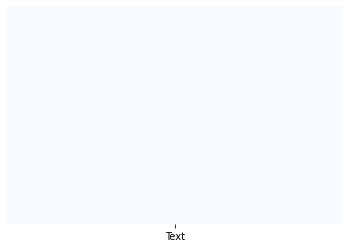

In [175]:
 # Checking for null elements
sns.heatmap(df.isnull(), yticklabels = False, cbar = False, cmap="Blues")

array([[<AxesSubplot:title={'center':'nps'}>]], dtype=object)

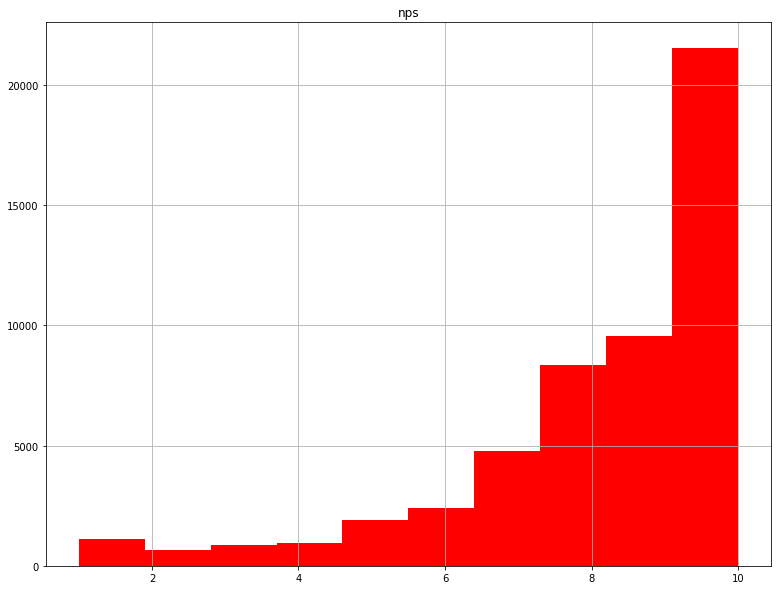

In [192]:
# Plotting Histogram of NPS data
df.hist(bins = 10, figsize = (13,10), color = 'r')

In [193]:
# Get length of NPS comments
df['length'] = df['Text'].apply(len)
df

,date_filled,nps,Text,length
0,2015-11-16,8,no,2
1,2015-12-11,10,thank you for everything i understand not eve...,132
2,2015-12-22,9,En mi experiencia con el comité UNINORTE en el...,347
3,2016-01-10,10,AIESEC Pacifico is one of best comittes I have...,174
4,2016-01-11,8,,0
5,2016-01-12,9,thanks for giving such a great experience but...,332
6,2016-01-12,9,I already gave the fb after the iternship to A...,68
7,2016-01-13,10,my experience was amazing every aiesec member...,72
8,2016-01-16,7,you guys are doing great just give more time t...,186
9,2016-01-17,10,,0


<AxesSubplot:ylabel='Frequency'>

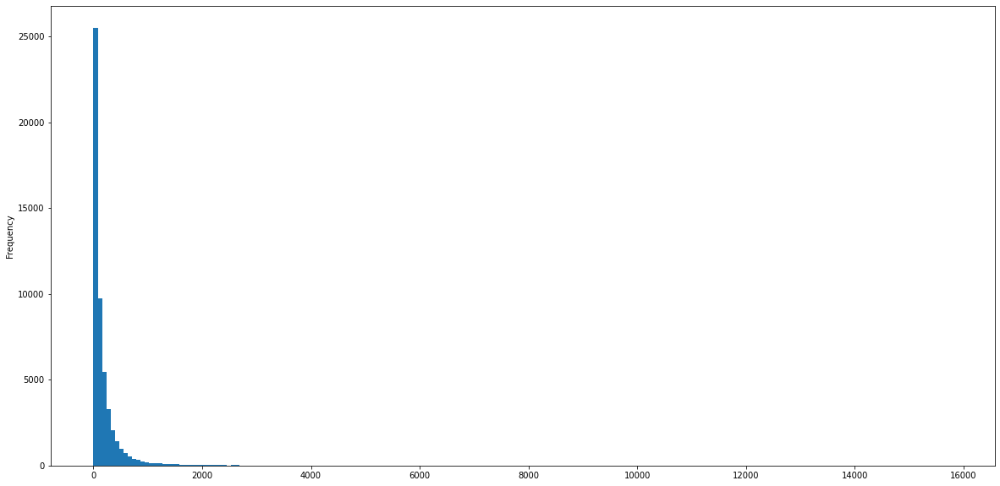

In [194]:
# Plotting NPS data
df['length'].plot(bins = 200, kind='hist', figsize=(20,10))

In [195]:
# information about the data with the length info
df.describe()

,nps,length
count,52090.000000,52090.000000
mean,8.337723,189.145172
std,2.124595,403.956465
min,1.000000,0.000000
25%,8.000000,21.000000
50%,9.000000,82.000000
75%,10.000000,208.000000
max,10.000000,15784.000000


In [196]:
# Check short message
df[df['length'] == 21]['Text'].iloc[0]

'Mejorar la parte de Delivery'

In [197]:
# Check message with average length
df[df['length'] == 189]['Text'].iloc[0]

'Everything good  amazing experience..'

# PERFORM DATA CLEANING
- REMOVE PUNCTUATION FROM TEXT
- REMOVE STOPWORDS

In [198]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [199]:
import nltk # Natural Language tool kit 
#nltk.download('stopwords')

In [200]:
# Natural Language Processing Kit library to identify stopwords
from nltk.corpus import stopwords
# stopwords.words('portuguese')
# stopwords.words('english')
# stopwords.words('spanish')

In [201]:
# Add words that aren't in the NLTK stopwords list
#stop_words = set(stopwords.words("english"))
#new_stopwords = ['apple','mango','banana']
#new_stopwords_list = stop_words.union(new_stopwords)

#print(stopwords.words('english'))

In [202]:
# Function to clean the text fro the dataframe, It performs:
# - Punctuation removal
# - Removal os stopwords in Engligh, Spanish and Portuguese (Most frequent in the dataset)

def message_cleaning(message):
    Test_punc_removed = [char for char in message if char not in string.punctuation]
    Test_punc_removed_join = ''.join(Test_punc_removed)
    Test_punc_removed_join_clean = [word for word in Test_punc_removed_join.split() if word.lower() not in stopwords.words('english')]
    Test_punc_removed_join_clean = [word for word in Test_punc_removed_join_clean if word.lower() not in stopwords.words('spanish')]
    Test_punc_removed_join_clean = [word for word in Test_punc_removed_join_clean if word.lower() not in stopwords.words('portuguese')]

    return Test_punc_removed_join_clean

In [203]:
df_clean = df['Text'].apply(message_cleaning)
df_clean

0                                                       []
1        [thank, everything, understand, everything, wo...
2        [experiencia, comité, UNINORTE, DicEne, 201520...
3        [AIESEC, Pacifico, one, best, comittes, ever, ...
4                                                       []
5        [thanks, giving, great, experience, think, AIE...
6          [already, gave, fb, iternship, AIESEC, company]
7        [experience, amazing, every, aiesec, member, w...
8        [guys, great, give, time, interns, know, exams...
9                                                       []
10                   [Improve, dissemination, information]
11                                                      []
12                        [magnificent, experience, Thank]
13             [excellent, organization, Keep, good, work]
14       [think, things, good, project, Hope, could, ai...
15       [lot, problems, logistic, AIESEC, Latina, Panama]
16                  [problems, solved, facing, rest, fin

# PLOT WORDCLOUD 

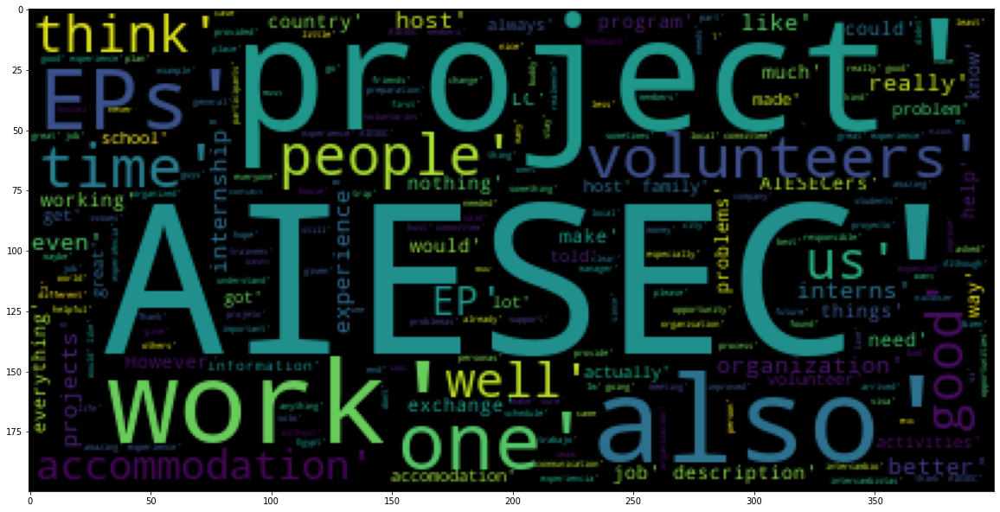

In [204]:
df_clean_join = "".join(map(str,df_clean))

from wordcloud import WordCloud

plt.figure(figsize=(20,20))
plt.imshow(WordCloud().generate(df_clean_join))

# PERFORM COUNT VECTORIZATION (TOKENIZATION)
- Objective: to determine the top 100 words mentioned in the text dataset

In [205]:
from sklearn.feature_extraction.text import CountVectorizer

In [206]:
#vectorizer = CountVectorizer(analyzer = message_cleaning, dtype = 'uint8')
#comments_countvectorizer = vectorizer.fit_transform(df_nps['comments']).toarray()

In [207]:
#print(vectorizer.get_feature_names())

In [208]:
def get_top_n_words(corpus, n=None):
    # Here we get a Bag of Word model that has cleaned the text, 
    # removing non-aphanumeric characters and stop words.
    vec = CountVectorizer(analyzer = message_cleaning, dtype = 'uint8').fit(corpus)
    # bag_of_words a matrix where each row represents a specific text
    # in corpus and each column represents a word in vocabulary
    bag_of_words = vec.transform(corpus)
    # sum_words is a vector that contains the sum of each word occurrence in all texts in the corpus
    sum_words = bag_of_words.sum(axis=0) 
    # Sort a list of tuples that contain the word and their occurrence in the corpus
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

In [209]:
# Data indicates: Word | Count of times it appears in all NPS responses
top_100 = get_top_n_words(df['Text'],100)

In [210]:
# Convert tuples to Dataframe
df_result = pd.DataFrame(top_100, columns=['Word','Occurrence'])
# Displays all rows from my dataset
pd.set_option("max_rows", None)
df_result

,Word,Occurrence
0,AIESEC,15959
1,experience,9352
2,project,9090
3,really,5214
4,good,5134
5,people,4762
6,would,4746
7,work,4341
8,us,4277
9,time,4097


In [186]:
# Copy Dataframe to clipboard
# f_result.to_clipboard(sep=',')  